In [1]:
import numpy as np
import pandas as pd

In [2]:

# on_bad_lines='skip' is important otherwise it will cause an error of "pandas.parser.CParserError: Error tokenizing data. C error: Expected 2 fields in line 3, saw 12"
path = "C:/Users/zaina/Desktop/FYDP/1_OriginalDataset_FashionProductImagesSmall/styles.csv"
df = pd.read_csv(path ,on_bad_lines='skip')

In [3]:
# df has mixed data of both Women, Girl, Men, Boys, Unisex 
df.head()

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt


In [4]:
# .info() gives the information about the dataset like the number of rows and columns, the number of non-null values in each column, and the datatype of each column.
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44424 entries, 0 to 44423
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  44424 non-null  int64  
 1   gender              44424 non-null  object 
 2   masterCategory      44424 non-null  object 
 3   subCategory         44424 non-null  object 
 4   articleType         44424 non-null  object 
 5   baseColour          44409 non-null  object 
 6   season              44403 non-null  object 
 7   year                44423 non-null  float64
 8   usage               44107 non-null  object 
 9   productDisplayName  44417 non-null  object 
dtypes: float64(1), int64(1), object(8)
memory usage: 3.4+ MB


In [5]:
df.describe()

,id,year
count,44424.000000,44423.000000
mean,29696.334301,2012.806497
std,17049.490518,2.126480
min,1163.000000,2007.000000
25%,14768.750000,2011.000000
50%,28618.500000,2012.000000
75%,44683.250000,2015.000000
max,60000.000000,2019.000000


In [6]:
# Checking If there are null values in the dataset
print(f'General check for null values \n{df.isna().any()}\n')
print(f'Names of columns that contain null values: \n{df.columns[df.isna().any()].tolist()}\n')
print(f'Number of columns containing missing values: \n{len(df.columns[df.isna().any()].tolist())}\n')
print(f'Number of missing values in each column: \n{df.isna().sum()}')


General check for null values 
id                    False
gender                False
masterCategory        False
subCategory           False
articleType           False
baseColour             True
season                 True
year                   True
usage                  True
productDisplayName     True
dtype: bool

Names of columns that contain null values: 
['baseColour', 'season', 'year', 'usage', 'productDisplayName']

Number of columns containing missing values: 
5

Number of missing values in each column: 
id                      0
gender                  0
masterCategory          0
subCategory             0
articleType             0
baseColour             15
season                 21
year                    1
usage                 317
productDisplayName      7
dtype: int64


In [7]:
# listing the columns with missing values 
missingVal = df.columns[df.isna().any()]
for i in missingVal:
    print(f'{i:<20}{df[i].isna().sum()}')


baseColour          15
season              21
year                1
usage               317
productDisplayName  7


In [8]:
# value_counts() gives the number of count of each class in a Feature/Column along with the Column's name and datatype 
df['gender'].value_counts()

Men       22147
Women     18631
Unisex     2161
Boys        830
Girls       655
Name: gender, dtype: int64

In [9]:
# dropping Rows having empty values 
# inplace = True is used to make the changes in the original dataset
df.dropna(inplace=True)
df['gender'].value_counts()

Men       22109
Women     18357
Unisex     2126
Boys        830
Girls       655
Name: gender, dtype: int64

In [10]:
# Again checking if there is any null value 
print(f'General check for null values \n{df.isna().any()}\n')


General check for null values 
id                    False
gender                False
masterCategory        False
subCategory           False
articleType           False
baseColour            False
season                False
year                  False
usage                 False
productDisplayName    False
dtype: bool



In [11]:
# Getting those values in a separate dataframe where gender = Men
maleDataSet = df.loc[(df['gender']=='Men') ]
maleDataSet['id'].count()

22109

In [12]:
boysDataSet = df.loc[(df['gender']=='Boys') ]
boysDataSet['id'].count()

830

In [13]:
uniSexDataSet = df.loc[(df['gender']=='Unisex') ]
uniSexDataSet['id'].count()

2126

In [14]:
# Concatenating all datasets of Men, Boys, Unisex
frames = [maleDataSet, boysDataSet, uniSexDataSet]  
result = pd.concat(frames)

print(f"Separated male dataset contain these values\n{result['gender'].value_counts()}\n")

print(f"Size of male dataset: {result['id'].count()}")

Separated male dataset contain these values
Men       22109
Unisex     2126
Boys        830
Name: gender, dtype: int64

Size of male dataset: 25065


In [15]:
result['usage'].value_counts()

Casual          19389
Sports           3244
Formal           2236
Ethnic            117
Smart Casual       54
Travel             22
Party               2
Home                1
Name: usage, dtype: int64

In [16]:
# # Filtering Pandas Dataframe

# # Create a sample DataFrame
# df = pd.DataFrame({'id': [1, 2, 3, 4, 5], 'value': ['a', 'b', 'c', 'a', 'b']})

# # Use boolean indexing to filter the DataFrame based on the condition
# filtered_df = df[df['value'] == 'a']

# # Get the values from the 'id' column of the filtered DataFrame
# id_values = filtered_df['id'].values

# # Print the results
# print(id_values)
 

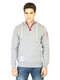

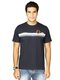

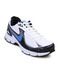

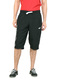

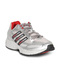

...

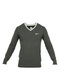

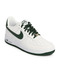

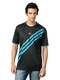

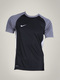

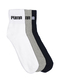

In [17]:
# Filtering male dataset to display the pics with a certain label
from tensorflow.keras.utils import load_img

filtered_result = result[result['usage'] == 'Sports']
id_values = filtered_result['id'].values
# print(id_values)

dir_path = '../2_SeparatingMaleDataset/maleDatasetImages/'
for id in id_values:
    pic_path = dir_path + str(id) + '.jpg'
    pic = load_img(pic_path)
    display(pic)

In [18]:
# dataframe to CSV file
# result.to_csv('./maleDataSet.csv', index=False)

In [19]:
# Moving male dataset files to separate folder 
# Some missing pics: 39403, 39410, 39401, 39425, 12347

# import shutil
# for id in result['id']:
#     if id==39403 or id==39410 or id==39401 or id==39425 or id==12347:
#         continue
#     else:    
#         old_path = 'C:/Users/zaina/Desktop/FYDP/1_OriginalDataset_FashionProductImagesSmall/images_copy/'+ str(id) + '.jpg'
#         new_path = 'C:/Users/zaina/Desktop/FYDP/2_SeparatingMaleDataset/maleDatasetImages/'+ str(id) + '.jpg'
#         shutil.move(old_path, new_path)